<a href="https://colab.research.google.com/github/KangPixel/AIFFEL_quest_cr/blob/master/Exploration/Ex06/Ex06_Node.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Stable Diffusion 설치
!pip install --upgrade -qq git+https://github.com/huggingface/diffusers.git transformers accelerate

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.5/43.5 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 42.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 84.3 MB/s eta 0:00:00


In [24]:
# 메모리 삭제
torch.cuda.empty_cache()

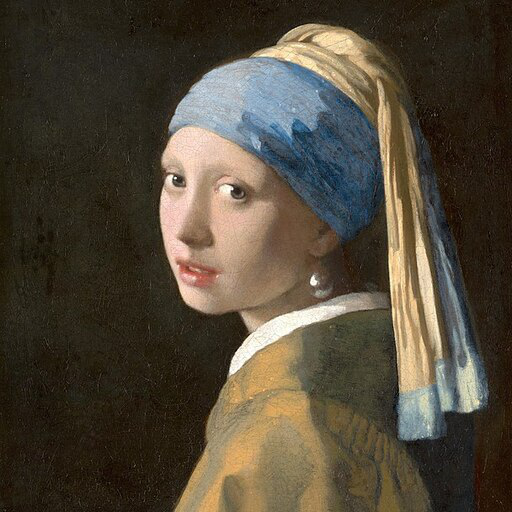

In [36]:
# 윤곽선 검출
import torch
from diffusers import StableDiffusionControlNetPipeline
from diffusers.utils import load_image

# 이미지 불러오기
image = load_image(
    "https://hf.co/datasets/huggingface/documentation-images/resolve/main/diffusers/input_image_vermeer.png"
)

image

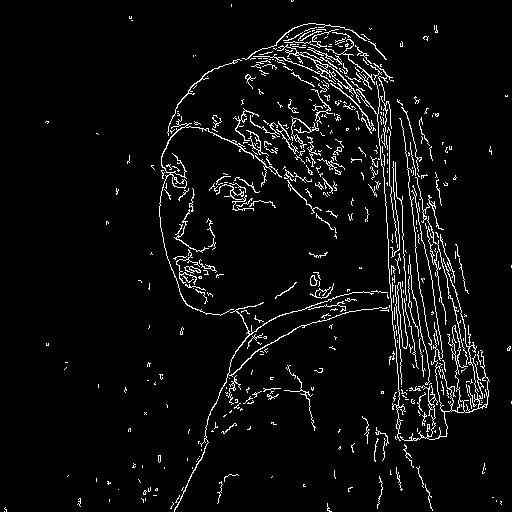

In [37]:
import cv2
from PIL import Image
import numpy as np

# 이미지를 NumPy 배열로 변환합니다.
image = np.array(image)

# threshold를 지정합니다.
low_threshold = 100
high_threshold = 200

# 윤곽선을 검출합니다.
image = cv2.Canny(image, low_threshold, high_threshold)
image = image[:, :, None]
image = np.concatenate([image, image, image], axis=2)
canny_image = Image.fromarray(image)  # NumPy 배열을 PIL 이미지로 변환합니다.

canny_image

In [4]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel

canny_controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-canny", torch_dtype=torch.float16)
canny_pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=canny_controlnet, torch_dtype=torch.float16
)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/920 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.45G [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

safety_checker/config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [47]:
from diffusers import UniPCMultistepScheduler
canny_pipe.scheduler = UniPCMultistepScheduler.from_config(canny_pipe.scheduler.config)
canny_pipe = canny_pipe.to("cuda")

# 동일한 이미지를 생성하기 위해 seed를 지정합니다.
generator = torch.manual_seed(0)

# 이미지를 생성합니다.
canny_image_1 = canny_pipe(
    prompt="disco dancer with colorful lights",
    num_inference_steps=20,
    generator=generator,
    image=canny_image
).images[0]

  0%|          | 0/20 [00:00<?, ?it/s]

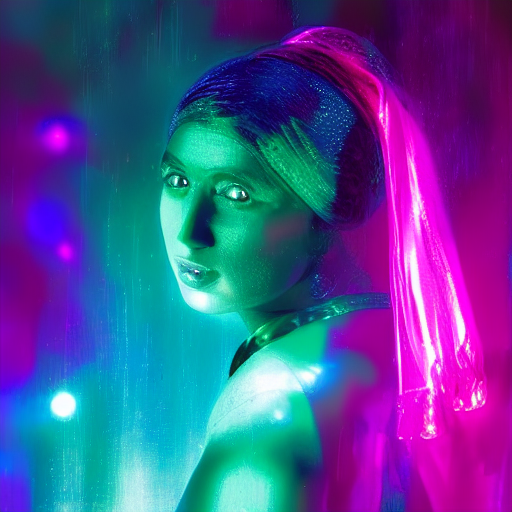

In [48]:
# 생성된 이미지를 저장합니다.
canny_image_1.save(f"/content/drive/MyDrive/Colab Notebooks/images/canny_image.png")  # "canny_image.png"라는 파일로 저장

# 생성된 이미지를 출력합니다.
canny_image_1

  0%|          | 0/20 [00:00<?, ?it/s]

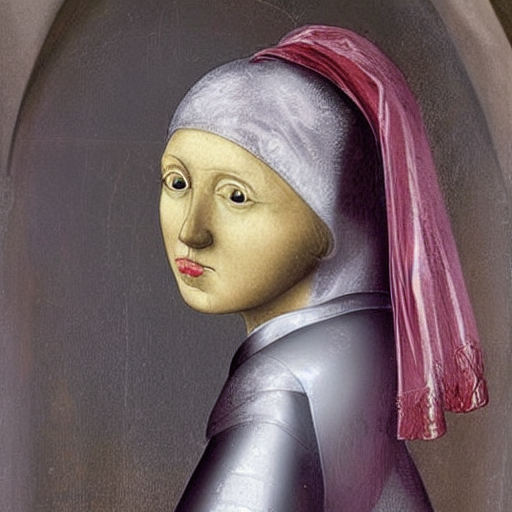

In [12]:
# 직접 조정하여 생성

import torch
from diffusers import StableDiffusionControlNetPipeline
from diffusers.utils import load_image

import cv2
from PIL import Image
import numpy as np

# 이미지 불러오기
image = load_image(
    "https://hf.co/datasets/huggingface/documentation-images/resolve/main/diffusers/input_image_vermeer.png"
)

image

# 이미지를 NumPy 배열로 변환합니다.
image = np.array(image)

# threshold를 지정합니다.
low_threshold = 100
high_threshold = 200

# 윤곽선을 검출합니다.
image = cv2.Canny(image, low_threshold, high_threshold)
image = image[:, :, None]
image = np.concatenate([image, image, image], axis=2)
canny_image = Image.fromarray(image)  # NumPy 배열을 PIL 이미지로 변환합니다.

canny_image

# 윤곽선을 추출한 이미지에 프롬프트를 적용하여 새로운 이미지를 생성
from diffusers import UniPCMultistepScheduler
canny_pipe.scheduler = UniPCMultistepScheduler.from_config(canny_pipe.scheduler.config)
canny_pipe = canny_pipe.to("cuda")

# 동일한 이미지를 생성하기 위해 seed를 지정합니다.
generator = torch.manual_seed(0)

# 이미지를 생성합니다.
canny_image = canny_pipe(
    prompt="The beautiful daughter of a medieval count",
    negative_prompt="low quality, blurry, dark, noisy",
    #"The beautiful daughter of a medieval count",
    #"Rock singer style look",
    #"A girl with a permed bob and deep eyes, Nallari style",  #그윽한 눈을 가진 뽀글머리 파마한 날라리 아가씨스타일
    #"A girl with a permed bob and a frizzy hair style",  #뽀글머리 파마한 날라리 아가씨스타일
    #"The image of a gorgeous Arabian Nights princess with big, bright eyes",   #아라비안나이트의 화려한 공주이미지
    #num_inference_steps=50,
    num_inference_steps=20,
    generator=generator,
    #guidance_scale=3.5,
    image=canny_image
).images[0]

# 생성된 이미지를 저장합니다.
canny_image.save(f"/content/drive/MyDrive/Colab Notebooks/images/canny_image_new9_1.png")

# 생성된 이미지를 출력합니다.
canny_image

In [8]:
#인체 자세 감지
# controlnet-aux를 설치합니다. Human pose를 검출해주는 controlnet의 보조용 모델입니다.
!pip install controlnet-aux==0.0.1

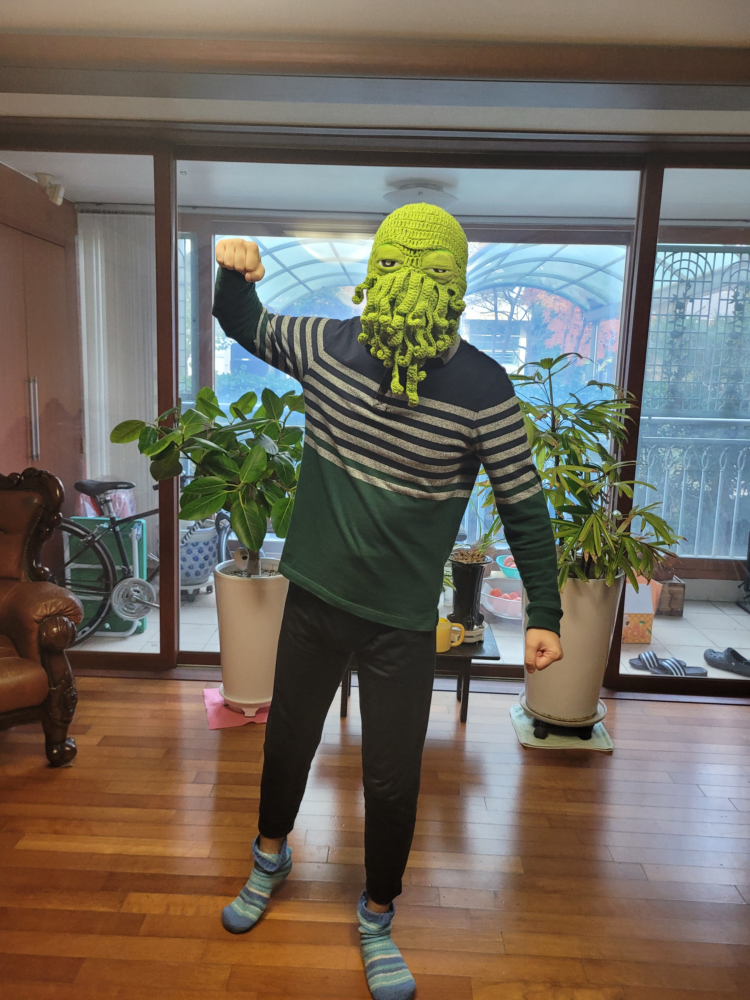

In [25]:
from diffusers.utils import load_image

# openpose_image = load_image(
#     "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/person.png"
# )
openpose_image = "/content/drive/MyDrive/Colab Notebooks/images/fist.jpg"

openpose_image

openpose_image = cv2.imread(openpose_image)
openpose_image = cv2.cvtColor(openpose_image, cv2.COLOR_BGR2RGB)
openpose_image = Image.fromarray(openpose_image)
openpose_image

cuda


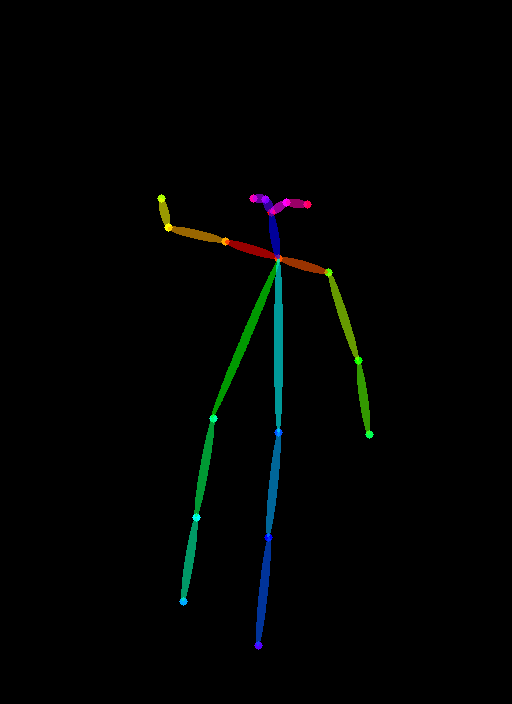

In [26]:
from controlnet_aux import OpenposeDetector

# 인체의 자세를 검출하는 사전 학습된 ControlNet 불러오기
openpose = OpenposeDetector.from_pretrained("lllyasviel/ControlNet")

# 이미지에서 자세 검출
openpose_image = openpose(openpose_image)
openpose_image

In [11]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel

openpose_controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-openpose", torch_dtype=torch.float16)
openpose_pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=openpose_controlnet, torch_dtype=torch.float16
)

config.json:   0%|          | 0.00/920 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.45G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

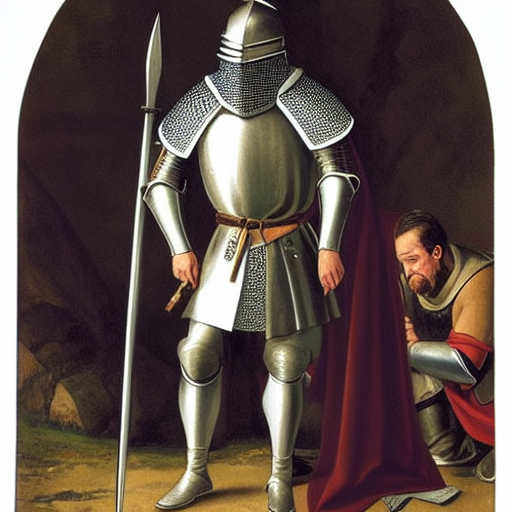

In [16]:
from diffusers import UniPCMultistepScheduler

openpose_pipe.scheduler = UniPCMultistepScheduler.from_config(openpose_pipe.scheduler.config)
openpose_pipe = openpose_pipe.to("cuda")

# Q. 코드를 작성해 보세요.
# 동일한 이미지를 생성하기 위해 seed를 넣어줍니다.
generator = torch.manual_seed(0)

#프롬프트를 작성합니다.
prompt =  "A pose of a knight fighting an enemy in the Middle Ages"  #중세시대 적군과 싸우는 기사의포즈
negative_prompt =  "low quality, blurry, dark, noisy"

images = openpose_image

# 이미지를 생성합니다.
openpose_image1 = openpose_pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=20,
    generator=generator,
    image=openpose_image
).images[0]

# 생성된 이미지를 저장합니다.
# openpose_image1.save(f"/content/drive/MyDrive/Colab Notebooks/images/openpose_image1.png")  #negative_prompt 값이 없는 경우
openpose_image1.save(f"/content/drive/MyDrive/Colab Notebooks/images/openpose_image2.png")  #negative_prompt 값이 있는 경우

# 생성된 이미지를 출력합니다.
openpose_image1

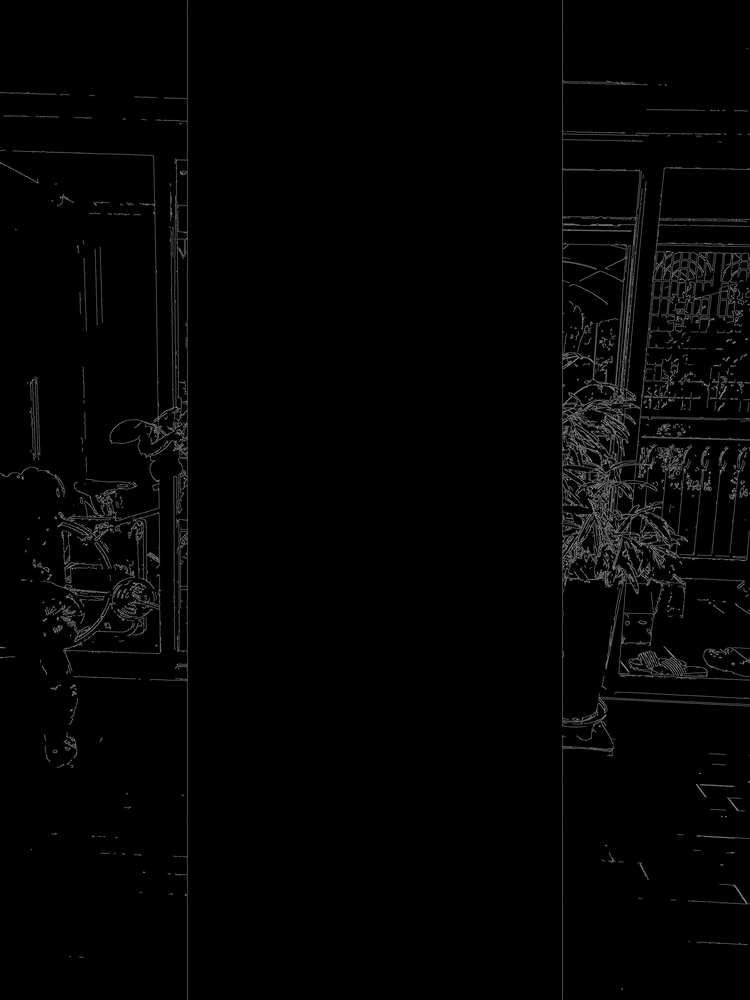

In [51]:
from PIL import Image
import cv2
import numpy as np

# 이미지를 불러옵니다.
canny_image_path = "/content/drive/MyDrive/Colab Notebooks/images/fist.jpg"
canny_image = cv2.imread(canny_image_path)
canny_image = cv2.cvtColor(canny_image, cv2.COLOR_BGR2RGB)

# 이미지를 NumPy 배열로 변환합니다.
canny_image = np.array(canny_image)

# 가운데 부분을 검은색으로 만듭니다.
zero_start = canny_image.shape[1] // 4
zero_end = zero_start + canny_image.shape[1] // 2
canny_image[:, zero_start:zero_end] = 0

# 윤곽선을 검출합니다.
low_threshold = 100
high_threshold = 200
canny_image = cv2.Canny(canny_image, low_threshold, high_threshold)

# PIL 이미지로 변환합니다.
canny_image = Image.fromarray(canny_image)

# 결과 확인
canny_image

cuda


/usr/local/lib/python3.10/dist-packages/controlnet_aux/open_pose/body.py:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_dict = util.transfer(self.model, torch.load(

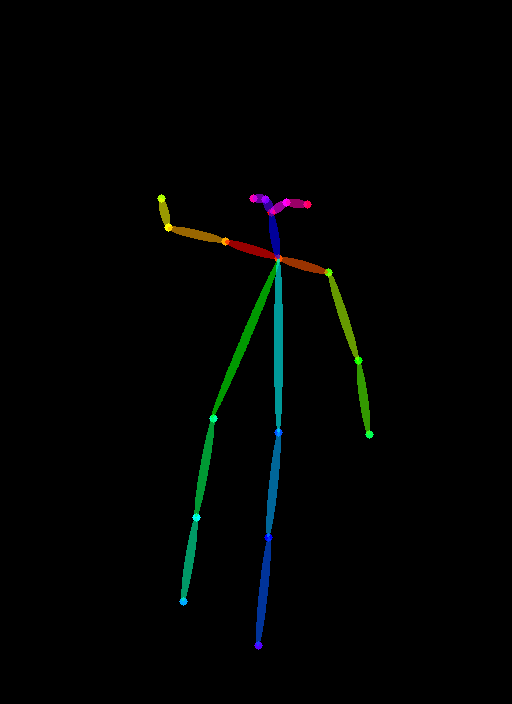

In [52]:
from controlnet_aux import OpenposeDetector
from diffusers.utils import load_image

# Q. 아래의 코드를 작성해 주세요.
# 이미지를 불러옵니다.
openpose_image = "/content/drive/MyDrive/Colab Notebooks/images/fist.jpg"

openpose_image = cv2.imread(openpose_image)
openpose_image = cv2.cvtColor(openpose_image, cv2.COLOR_BGR2RGB)
openpose_image = Image.fromarray(openpose_image)
openpose_image

# OpenposeDetector를 사용하여 인체 자세를 검출합니다.
openpose = OpenposeDetector.from_pretrained("lllyasviel/ControlNet")
openpose_image = openpose(openpose_image)
openpose_image

In [ ]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, UniPCMultistepScheduler

# Q. 코드를 작성해 보세요.
# Edge Detection과 Openpose, 2개의 전처리기를 controlnets라는 리스트로 만듭니다.
controlnets = [
    ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-canny", torch_dtype=torch.float16),
    ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-openpose", torch_dtype=torch.float16)
]

# 리스트 controlnets를 파이프라인으로 전달합니다.
pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    controlnet=controlnets,
    torch_dtype=torch.float16
)

pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)
pipe = pipe.to("cuda")

# 프롬프트를 작성합니다.
prompt =  "A joyful man dancing on a cobblestone street, quaint European village, twilight sky, warm golden streetlights, vibrant colorful houses, flowers, bustling small-town charm, graceful energetic movements"
negative_prompt =  "darkness, sadness, chaos, blurry, distorted, low quality, dull colors, monotone, overexposed, underexposed, crowded, cluttered, low detail, artificial, unrealistic, grainy, pixelated, flat"

# seed를 지정합니다.
generator = torch.manual_seed(0)

images = [openpose_image, canny_image]

# 이미지를 생성합니다.
image =  pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    # num_inference_steps=20,
    image=images,
    generator=generator
    ).images[0]

# 생성된 이미지를 저장합니다.
image.save("aiffel/aiffel/multi_controlnet_output.png")
image.save(f"/content/drive/MyDrive/Colab Notebooks/images/openpose_image2.png")


# 생성된 이미지를 출력합니다.
image

In [ ]:
print("생성한 이미지를 올린 곳은 [[YOUR CODE]]입니다.")